<a href="https://colab.research.google.com/github/lauraemmanuella/AgroDigitalNE/blob/main/AgroDigital_NE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Compilado de artigos publicados por pesquisadores do NE nos eventos [SBIAGRO](https://www.sbiagro.org/) e [CONBAP](https://www.asbraap.org/conbap/)


Levantamento feito pelo grupo de pesquisa *“Modelagem, Identificação e Controle de Sistemas Agrários”*


http://tapioca.eaj.ufrn.br/

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd /content/drive/MyDrive/Colab Notebooks/AgroDigitalNE

/content/drive/MyDrive/Colab Notebooks/AgroDigitalNE


In [3]:
import folium
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

#Dataset Construído

In [4]:
base = './levantamento.xlsx' #arquivo com detalhamentos do levantamento

In [5]:
df = pd.read_excel(base, 'compilacao') #planilha com compilado final

In [22]:
df.head()

,Evento,Título do trabalho,Palavras chaves,Instituições,Pesquisadores,Área de aplicação,Área técnica
0,SBIAgro 2019,PisciculTec: um sistema WEB para gerenciamento...,Psicultura; Sistemas de gestão,UFAPE; UFRPE,Mateus Rodrigues; Igor M Vanderlei; Luis Filip...,Produção animal,Sistema de informação
1,SBIAgro 2019,Horus Green: Sistema para Monitoramento do Cre...,Processamento de imagens; Alface,UFRN-EAJ,Leonardo Teixeira,Produção vegetal,Processamento digital de imagens
2,SBIAgro 2019,Algoritmos Genéticos para Otimização em Sistem...,Ruminantes; Pastagens; Algoritmos genéticos,UFRN-EAJ,Laura Santana; Joel Santos ; Henrique Medeiros,Produção animal,Otimização
3,SBIAgro 2019,Predição da germinação de sementes de soja usa...,Machine learning; sementes; soja,UFRN-EAJ,Laura Santana; Iaslan Silva; Wesley Silva; Már...,Produção vegetal,Aprendizado de máquina
4,SBIAgro 2019,Impactos da IoT na Avicultura: um Mapeamento S...,IoT; Avicultura,UFAPE,Felipe Oliveira; Alixandre Santana; Luis Fili...,Produção animal,Internet das coisas


#Áreas de Aplicação e Áreas Técnicas

In [ ]:
groupAplicacao = df['Área de aplicação'].value_counts()

In [ ]:
groupAplicacao

Produção vegetal         29
Produção animal          10
Solo                      7
Irrigação                 6
Monitoramento de área     4
Pragas                    3
Gestão                    3
Estufa                    2
Clima                     2
Silos                     2
Umidade do ar             1
Entomologia               1
Name: Área de aplicação, dtype: int64

In [ ]:
def autopct_fun(abs_values):
  gen = iter(abs_values)
  return lambda pct: f"{pct:.1f}% ({next(gen)})"

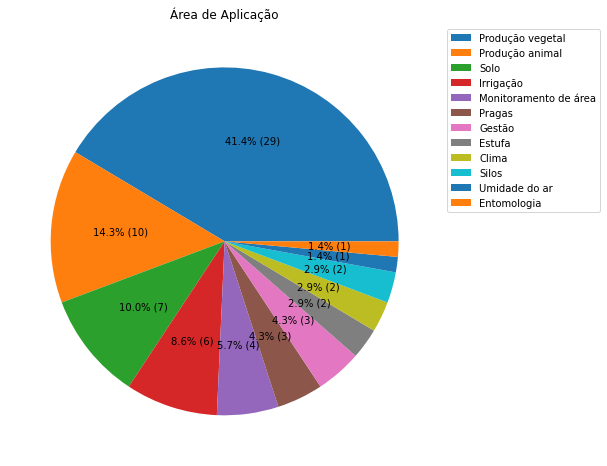

In [ ]:
fig, ax1 = plt.subplots(figsize = (8,8)) 
plt.pie(groupAplicacao, autopct=autopct_fun(groupAplicacao))
plt.legend(groupAplicacao.index, loc="best", bbox_to_anchor=(1,1))
plt.title('Área de Aplicação')
plt.show()
fig.savefig('./Aplicacao.png')

In [ ]:
groupTecnica = df['Área técnica'].value_counts()

In [ ]:
groupTecnica

Aprendizado de máquina              10
Processamento digital de imagens    10
Análise de dados                     8
Sistema de informação                7
Internet das coisas                  6
Geoestatística                       6
Otimização                           5
Modelagem matemática                 5
Automação                            5
Digitalização 3D                     2
Visão computacional                  2
Mapa de produtividade                1
Geoprocessamento                     1
Sistema especialista                 1
Modelagem numérica                   1
Name: Área técnica, dtype: int64

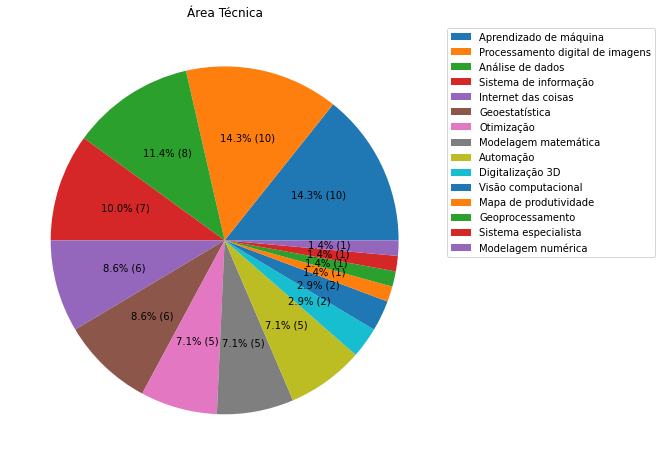

In [ ]:
fig, ax1 = plt.subplots(figsize = (8,8)) 
plt.pie(groupTecnica, autopct=autopct_fun(groupTecnica))
plt.legend(groupTecnica.index, loc= 'best', bbox_to_anchor=(1,1))
plt.title('Área Técnica')
plt.show()
fig.savefig('./Tecnica.png')

# Publicações por estado

In [ ]:
df_UF_SBIAGRO = pd.read_excel(base, 'UF_SBIAGRO')
df_UF_CONBAP = pd.read_excel(base, 'UF_CONBAP')

In [ ]:
df_UF_SBIAGRO

,Edição,AL,BA,CE,MA,PB,PE,PI,RN,SE
0,2005,0,1,2,1,0,2,1,0,1
1,2007,0,0,0,0,0,1,1,0,1
2,2009,0,3,3,0,1,2,0,0,0
3,2011,0,2,2,0,0,1,0,1,0
4,2013,0,0,0,0,0,4,0,2,0
5,2015,0,2,0,1,4,0,0,0,1
6,2017,0,2,1,0,0,0,0,0,0
7,2019,0,0,0,0,0,3,0,4,0


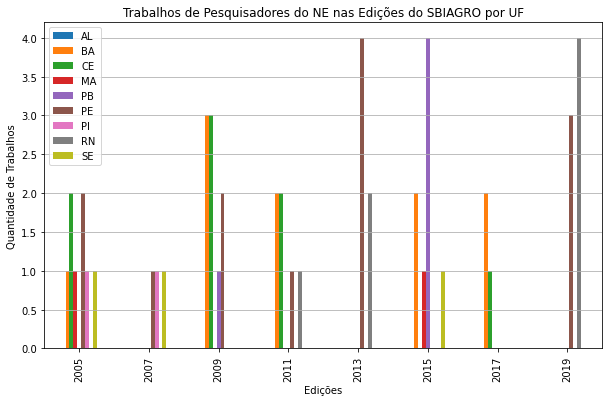

In [ ]:
df_UF_SBIAGRO.plot( x = 'Edição', y = ['AL','BA','CE','MA','PB','PE','PI','RN','SE'], kind='bar', figsize=(10,6))

# Plot formatting
plt.legend(prop={'size': 10})
plt.title('Trabalhos de Pesquisadores do NE nas Edições do SBIAGRO por UF', fontsize=12)
plt.xlabel('Edições', fontsize=10)
plt.ylabel('Quantidade de Trabalhos', fontsize=10)
plt.grid(axis = 'y')
plt.savefig('./UF_SBIAGRO.png')


In [ ]:
df_UF_CONBAP

,Edição,AL,BA,CE,MA,PB,PE,PI,RN,SE
0,2014,0,3,0,0,2,1,0,1,0
1,2016,0,5,1,0,0,2,0,0,0
2,2018,0,2,0,0,0,5,0,0,1


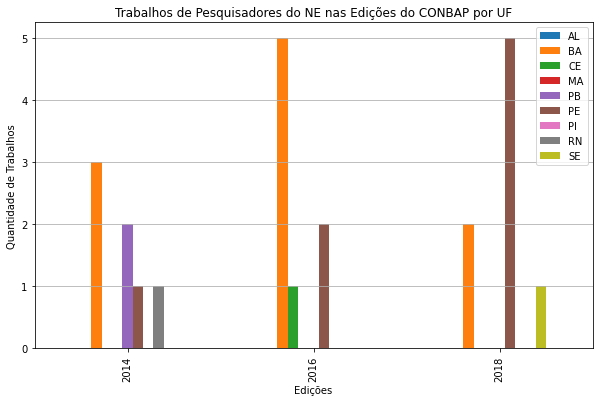

In [ ]:
df_UF_CONBAP.plot( x = 'Edição', y = ['AL','BA','CE','MA','PB','PE','PI','RN','SE'], kind='bar', figsize=(10,6))
# Plot formatting
plt.legend(prop={'size': 10})
plt.title('Trabalhos de Pesquisadores do NE nas Edições do CONBAP por UF', fontsize=12)
plt.xlabel('Edições', fontsize=10)
plt.ylabel('Quantidade de Trabalhos', fontsize=10)
plt.grid(axis='y')
plt.savefig('./UF_CONBAP.png')

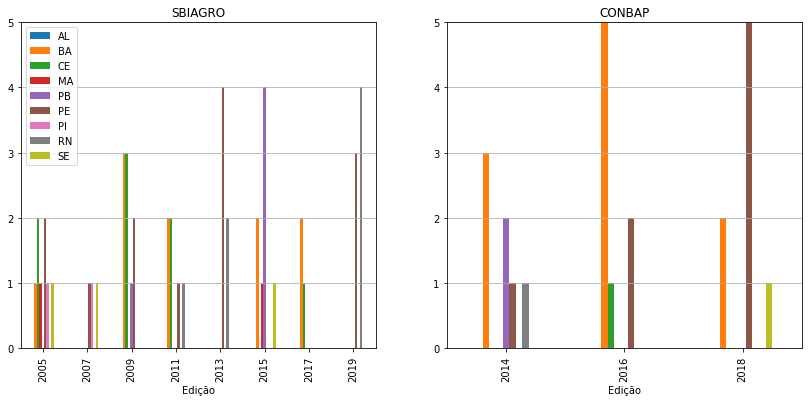

In [ ]:
fig1, eixos = plt.subplots(nrows=1, ncols=2, figsize=(14,6))

df_UF_SBIAGRO.plot(ax=eixos[0], x = 'Edição', y = ['AL','BA','CE','MA','PB','PE','PI','RN','SE'], kind='bar')
eixos[0].set_title('SBIAGRO')
eixos[0].set_ylim(0,5)
eixos[0].grid(axis='y')

df_UF_CONBAP.plot(ax=eixos[1], x = 'Edição', y = ['AL','BA','CE','MA','PB','PE','PI','RN','SE'], kind='bar', legend = False)
eixos[1].set_title('CONBAP')
eixos[1].set_ylim(0,5)
eixos[1].grid(axis='y')

plt.savefig('./UF.png')

plt.show()

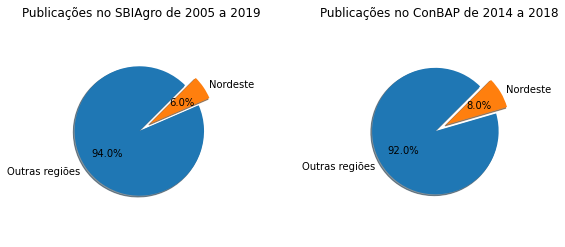

In [ ]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = 'Outras regiões', 'Nordeste'
explode = (0, 0.2)  # only "explode" the 2nd slice (i.e. 'Hogs')
sizesSBIAGRO = [94, 6]
sizesCONBAP = [92, 8]

fig1, eixos = plt.subplots(nrows=1, ncols=2, figsize=(8,4))

ax1 = eixos[0].pie(sizesSBIAGRO, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=45)
eixos[0].set_title('Publicações no SBIAgro de 2005 a 2019')
eixos[0].axis('equal')

ax2 = eixos[1].pie(sizesCONBAP, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=45)
eixos[1].set_title('Publicações no ConBAP de 2014 a 2018')
eixos[1].axis('equal')

# Ajusta o espaço entre os dois gráficos
plt.subplots_adjust(wspace=1)

plt.savefig('./RESUMO_PIE.png')

plt.show()

# Resumo das publicações por estado (mapa de calor)

https://towardsdatascience.com/choropleth-maps-with-folium-1a5b8bcdd392

https://deparkes.co.uk/2016/06/10/folium-map-tiles/

https://medium.com/@louisartur53/an%C3%A1lise-e-visualiza%C3%A7%C3%A3o-espacial-de-dados-reais-em-python-com-folium-cd4650fc5930


https://medium.com/@datalivre/folium-d6036a9ad29c

In [ ]:
NE_estados = './NE_states.json'

In [ ]:
geo_json_data = json.load(open(NE_estados))

In [ ]:
# we loop through the dictionary to obtain the name of the states in the json file
denominations_json = []
for index in range(len(geo_json_data['features'])):
    denominations_json.append(geo_json_data['features'][index]['properties']['name'])
    
denominations_json

['Alagoas',
 'Bahia',
 'Ceará',
 'Maranhão',
 'Paraíba',
 'Pernambuco',
 'Piauí',
 'Rio Grande do Norte',
 'Sergipe']

In [ ]:
# create a plain world map
mapa = folium.Map(
    width=600, height=600,
    location=[-8.8864889,-39.6786708], 
    zoom_start=5.3,
    tiles='Mapbox Bright'
)
folium.GeoJson(geo_json_data).add_to(mapa)
mapa

In [ ]:
df_UF = pd.concat([df_UF_SBIAGRO, df_UF_CONBAP])

In [ ]:
df_UF

,Edição,AL,BA,CE,MA,PB,PE,PI,RN,SE
0,2005,0,1,2,1,0,2,1,0,1
1,2007,0,0,0,0,0,1,1,0,1
2,2009,0,3,3,0,1,2,0,0,0
3,2011,0,2,2,0,0,1,0,1,0
4,2013,0,0,0,0,0,4,0,2,0
5,2015,0,2,0,1,4,0,0,0,1
6,2017,0,2,1,0,0,0,0,0,0
7,2019,0,0,0,0,0,3,0,4,0
0,2014,0,3,0,0,2,1,0,1,0
1,2016,0,5,1,0,0,2,0,0,0


In [ ]:
df_total_UF = pd.DataFrame(df_UF[['AL', 'BA', 'CE', 'MA', 'PB', 'PE', 'PI', 'RN', 'SE']].sum(), columns= ['QtdTrabalhos'])

In [ ]:
df_total_UF.index.name = 'SIGLA'

In [ ]:
df_total_UF['Estado'] = denominations_json

In [ ]:
df_total_UF

,QtdTrabalhos,Estado
SIGLA,,
AL,0,Alagoas
BA,20,Bahia
CE,9,Ceará
MA,2,Maranhão
PB,7,Paraíba
PE,21,Pernambuco
PI,2,Piauí
RN,8,Rio Grande do Norte
SE,4,Sergipe


In [ ]:
# generate choropleth map 
folium.Choropleth(
    geo_data=geo_json_data,
    data=df_total_UF,
    columns=['Estado', 'QtdTrabalhos'],
    key_on='feature.properties.name',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Acumulado dos trabalhos de pesquisadores do NE no SBIAGRO e CONBAP',
    smooth_factor=0).add_to(mapa)

# display map
mapa

# Nuvem de palavras (Resumo das palavras chaves e instituições)

https://sigmoidal.ai/como-criar-uma-wordcloud-em-python/

https://github.com/carlosfab/sigmoidal_ai/blob/master/Como_Criar_uma_WordCloud_em_Python.ipynb

In [6]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [7]:
palavraschaves = df['Palavras chaves']

In [9]:
palavraschaves.dropna(inplace=True)

In [12]:
listapalavras = palavraschaves.to_list()

In [14]:
# concatenar as palavras
listapalavras = " ".join(s for s in listapalavras)

# ver quantidade de palavras
print("Quantidade de Palavras: {}".format(len(listapalavras)))

Quantidade de Palavras: 4493


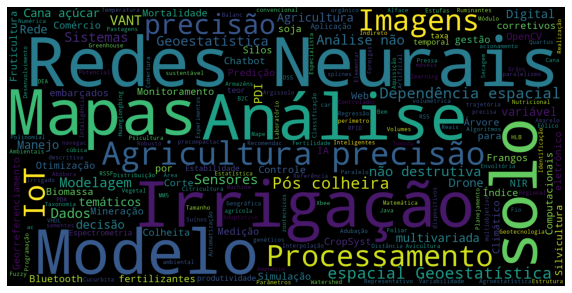

In [ ]:
# lista de stopword
stopwords = set(STOPWORDS)
stopwords.update(["da", "de", "do", "em", "a", "ao", "os", "na", "sistema", "artificiais", "um", "sem"])

# gerar uma wordcloud
wordcloud = WordCloud(stopwords = stopwords, background_color="black",
                      width=1600, height=800, normalize_plurals= True).generate(listapalavras)

# mostrar a imagem final
fig, ax = plt.subplots(figsize=(10,6))
ax.imshow(wordcloud, interpolation='bilinear')
ax.set_axis_off()

plt.imshow(wordcloud);
wordcloud.to_file('./keywords.png')

In [16]:
instituicao = df['Instituições']

In [18]:
instituicao.dropna(inplace=True)

In [19]:
listaInstituicao = instituicao.to_list()

In [20]:
# concatenar as palavras
listaInstituicao = " ".join(s for s in listaInstituicao)

# ver quantidade de palavras
print("Quantidade de Palavras: {}".format(len(listaInstituicao)))

Quantidade de Palavras: 1732


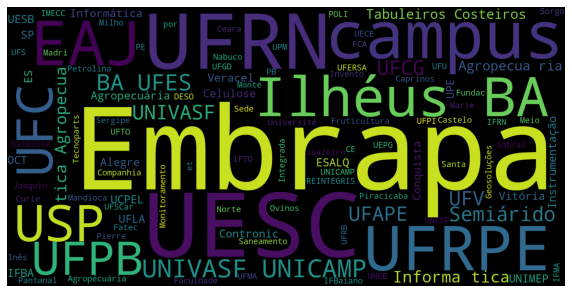

In [21]:
# lista de stopword
stopwords = set(STOPWORDS)
stopwords.update(["da", "de", "do", "em", "a", "ao", "os", "na", "um", "sem"])

# gerar uma wordcloud
wordcloud = WordCloud(stopwords = stopwords, background_color="black",
                      width=1600, height=800, normalize_plurals= True).generate(listaInstituicao)

# mostrar a imagem final
fig, ax = plt.subplots(figsize=(10,6))
ax.imshow(wordcloud, interpolation='bilinear')
ax.set_axis_off()

plt.imshow(wordcloud);
wordcloud.to_file('./instituicoes.png')